In [ ]:
from trading.strategy.backtester import BacktestTemplate, zscore
from functools import cache
import numpy as np
import pandas as pd
from datetime import datetime, timedelta, timezone
from pytimeparse.timeparse import timeparse
import pandas_ta as ta
from sklearn.preprocessing import MinMaxScaler
import numpy as np
from sklearn.linear_model import LinearRegression


Loading BokehJS ...

# R-squared Trend


In [ ]:
import statsmodels.api as sm
from statsmodels.regression.rolling import RollingOLS


class RSquaredTrend(BacktestTemplate):
    def _process_signal(self, **kwargs) -> pd.DataFrame:
        df = self._1m_candle.copy().resample(self.param["freq"]).agg({'open': 'first', 'high': 'max', 'low': 'min', 'close': 'last'})

        # Initialize columns to store rolling regression results
        df['slope'] = np.nan
        df['intercept'] = np.nan
        df['r_squared'] = np.nan

        # Calculate rolling regression using RollingOLS
        X = np.arange(len(df)).reshape(-1, 1)
        rolling_ols = RollingOLS(endog=df['close'],
                                exog=sm.add_constant(X),
                                window=self.param['rolling_window'])
        rolling_res = rolling_ols.fit()

        df['intercept'] = rolling_res.params.iloc[:,0]
        df['slope'] = rolling_res.params.iloc[:,1]
        df['r_squared'] = rolling_res.rsquared

        # Shift indicator and z-scores to avoid lookahead bias
        df['indicator'] = (df['slope'] * df['r_squared']).shift(1)
        df['z_scores'] = zscore(df['indicator'], lookback=self.param['lookback'])

        return df

x = RSquaredTrend("BTCUSDT", execution_delay=0, backtest_model="zscore")
kwargs = {"freq": "1h", "rolling_window": 100,"lookback": 500, "enter_Z": 2, "exit_Z": 1}
x.set_param(**kwargs)
x.plot_results()

Final Balance: 250.31
Win Rate: 47.22%
Number of trades: 72
Sharpe: 1.34
Calmar: 2.15
Max Drawdown: 15.72%
Annualized Return: 35.90%
Average Trades per Week: 0.5
Median Holding Period: 2 days 01:00:00


In [ ]:
param_grid = {"freq":["1h","4h"], "rolling_window":range(50, 200, 10), "lookback": range(200, 1000, 100), "enter_Z": [1.5,2,2.5], "exit_Z": [None,0.1, 1]}
result = x.optimize(param_grid)

  0%|          | 0/2160 [00:00<?, ?it/s]

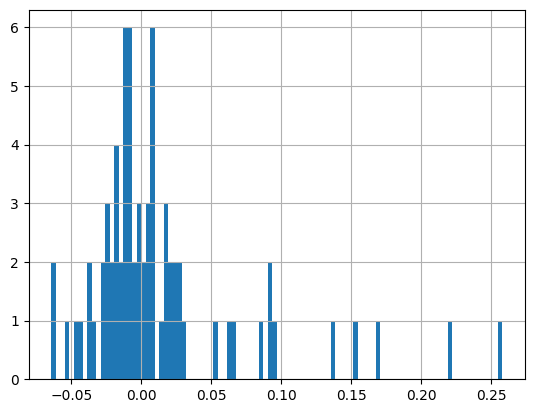

In [ ]:
x.plot_returns_distribution()

,freq,rolling_window,lookback,enter_Z,exit_Z,sharpe,mdd,calmar,final_bal,n_trades,hit_rate,long_hit_rate,short_hit_rate,avg_hold_period
0,1h,160,500,2.0,1.0,1.823792,0.234937,2.627515,502.663002,48,0.666667,0.750000,0.583333,3 days 23:22:30
1,1h,170,700,1.5,1.0,1.814738,0.281200,2.316733,471.867234,50,0.620000,0.772727,0.500000,4 days 10:12:00
2,1h,120,500,2.0,NaN,1.782273,0.199062,2.576561,413.466045,58,0.603448,0.500000,0.714286,2 days 00:43:26.896551724
3,1h,90,400,2.0,0.1,1.781246,0.334186,1.971143,567.676247,75,0.546667,0.526316,0.567568,3 days 12:24:00
4,1h,130,500,2.0,NaN,1.777640,0.200820,2.444522,392.777831,54,0.574074,0.461538,0.678571,2 days 05:28:53.333333333
5,1h,120,400,2.0,1.0,1.773528,0.175908,3.275904,489.436216,67,0.582090,0.545455,0.617647,2 days 19:49:15.223880597
6,1h,90,300,2.0,0.1,1.763636,0.261046,2.563392,617.552964,92,0.554348,0.510638,0.600000,3 days 05:52:49.565217391
7,1h,80,400,2.0,0.1,1.743832,0.350916,1.774003,535.402672,81,0.604938,0.605263,0.604651,3 days 02:20:00
8,1h,150,600,2.0,1.0,1.730870,0.217610,2.669091,455.353103,43,0.581395,0.590909,0.571429,3 days 23:34:53.023255813
9,1h,90,200,2.0,0.1,1.704014,0.220475,2.925666,552.688099,118,0.500000,0.500000,0.500000,3 days 01:54:54.915254237


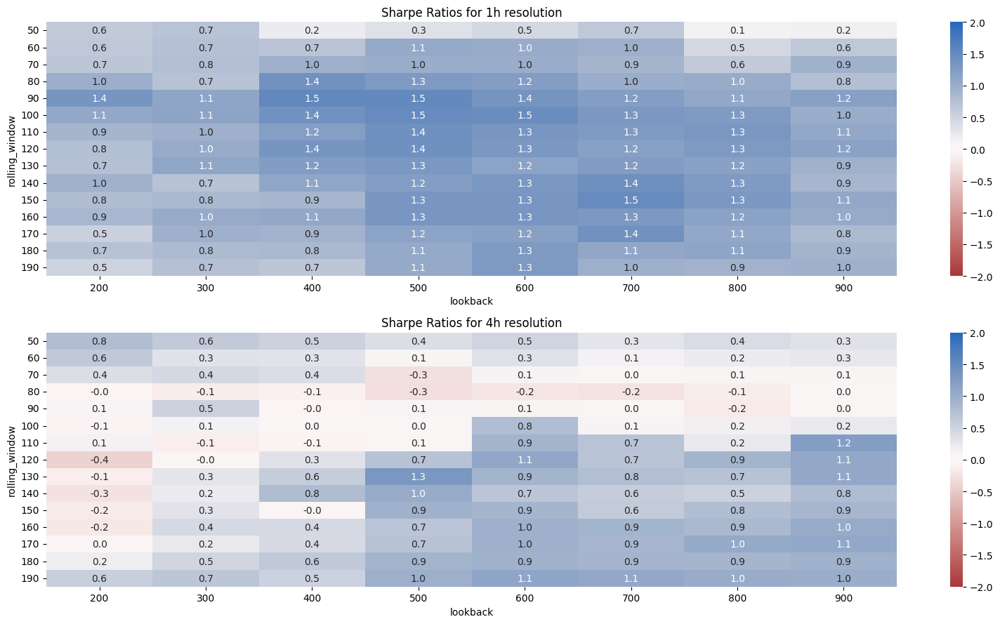

In [ ]:
display(result.query("n_trades > 10").sort_values(by='sharpe', ascending=False).iloc[:20].reset_index(drop=True))

import seaborn as sns
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 1, figsize=(16, 9))
axes = axes.flatten()

for i, freq in enumerate(result.freq.unique()):
    sns.heatmap(result[result['freq']==freq].pivot_table(index="rolling_window", columns="lookback", values="sharpe", aggfunc=lambda x: x.quantile(0.75)),
                cmap="vlag_r", vmax=2, vmin=-2, annot=True, fmt=".1f", ax=axes[i]).set_title(f"Sharpe Ratios for {freq} resolution")

plt.tight_layout()
plt.show()